<h1>Summary</h1>
This contains various things.

In [1]:
using SDDP, Gurobi, LinearAlgebra, Distributions, CSV, DataFrames, Plots, Statistics, StrLiterals

# Problem Data
T = 3  # Total number of years --> 2025, 2030, 2035

# read excel file for load profile
filename = joinpath(@__DIR__, "DH-Capacity-Expansion/LoadProfile.csv")
load_profile = CSV.read(filename, DataFrames.DataFrame, delim=";", decimal = ',')
load_profile = collect(load_profile[:, "load"])
load_profile_normalized = load_profile ./ sum(load_profile)


8760-element Vector{Float64}:
 0.00024514077660215235
 0.00024488026570215006
 0.0002454881245021554
 0.00024791955980217676
 0.000248180070702179
 0.00024878792950218436
 0.00025026415810219734
 0.00025182722360221106
 0.0002493957883021897
 0.00024670384220216605
 0.0002406252540021127
 0.00023220206760203872
 0.00022464725080197242
 ⋮
 0.0003502135148030749
 0.00034526380730303145
 0.0003429192090030109
 0.0003432665569030139
 0.0003465663619030429
 0.0003489109601030635
 0.0003558579180031244
 0.00036705988760322284
 0.0003766119547033067
 0.00038329840170336536
 0.00038329840170336536
 0.0003766119547033067

<h1>Typical Days Creation</h1>

In [443]:
profile = load_profile_normalized

n_typical_hours = 1000

quants = quantile(profile, LinRange(0,1,n_typical_hours))

diff = (reshape(profile, (size(load_profile)...,1)) .- quants').^2
mindist = argmin(diff, dims = 2)
second_component = getindex.(mindist, 2)


typical_hours = []
for (index,quant) in enumerate(quants)
    typical_hour = Dict(
        :value => quant,
        :qty => count(x -> x == index, second_component)
    )
    
    push!(typical_hours, typical_hour)
end




############## Process electricity prices into typical hours ##################
filename_elec_2030 = joinpath(@__DIR__, "DH-Capacity-Expansion/ElectricityPrice2030.csv")
elec_price_2030 = CSV.read(filename_elec_2030, DataFrames.DataFrame, delim=",", decimal='.')
elec_price_2030 = collect(elec_price_2030[:, "price"])
sale_elec_price_2030 = round.(elec_price_2030, digits=2)
purch_elec_price_2030 = elec_price_2030 .+ 50

filename_elec_2050 = joinpath(@__DIR__, "DH-Capacity-Expansion/ElectricityPrice2050.csv")
elec_price_2050 = CSV.read(filename_elec_2050, DataFrames.DataFrame, delim=",", decimal='.')
elec_price_2050 = collect(elec_price_2050[:, "price"])
sale_elec_price_2050 = round.(elec_price_2050, digits=2)
purch_elec_price_2050 = elec_price_2050 .+ 50

typical_hour_indices = second_component
n_original_hours = length(load_profile)

# Initialize typical electricity prices for 2030 and 2050
c_purch_elec_price_2030_typical = zeros(n_typical_hours)
c_purch_elec_price_2050_typical = zeros(n_typical_hours)
c_sale_elec_price_2030_typical = zeros(n_typical_hours)
c_sale_elec_price_2050_typical = zeros(n_typical_hours)

unique(second_component)
# print(second_component)
sort(unique(second_component))

for i in 1:n_typical_hours
    hours_in_cluster = findall(x -> x == i, typical_hour_indices)
    c_purch_elec_price_2030_typical[i] = mean(purch_elec_price_2030[hours_in_cluster])
    c_purch_elec_price_2050_typical[i] = mean(purch_elec_price_2050[hours_in_cluster])
    c_sale_elec_price_2030_typical[i] = mean(sale_elec_price_2030[hours_in_cluster])
    c_sale_elec_price_2050_typical[i] = mean(sale_elec_price_2050[hours_in_cluster])
end


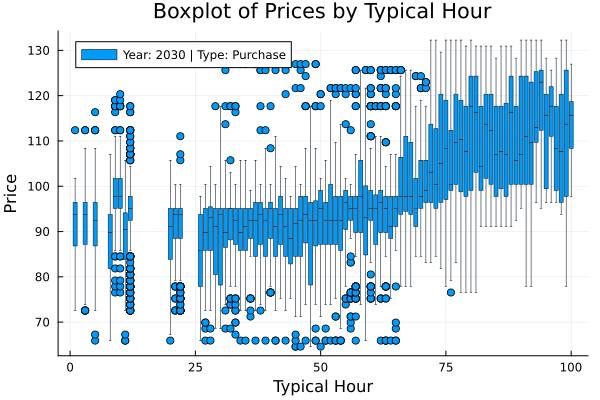

attempt to save state beyond implementation limit
attempt to save state beyond implementation limit


In [437]:
using DataFrames

# Create an empty list to accumulate rows
all_rows = []

# Loop over each typical hour and store all values in the list
for i in 1:n_typical_hours
    hours_in_cluster = findall(x -> x == i, typical_hour_indices)
    
    # Add rows for each combination of Year and Type to the list
    append!(all_rows, [(i, 2030, "Purchase", p) for p in purch_elec_price_2030[hours_in_cluster]])
    append!(all_rows, [(i, 2050, "Purchase", p) for p in purch_elec_price_2050[hours_in_cluster]])
    append!(all_rows, [(i, 2030, "Sale", p) for p in sale_elec_price_2030[hours_in_cluster]])
    append!(all_rows, [(i, 2050, "Sale", p) for p in sale_elec_price_2050[hours_in_cluster]])
end

# Convert the accumulated rows into a DataFrame all at once
df = DataFrame(all_rows, [:TypicalHour, :Year, :Type, :Price])

# Sort DataFrame by TypicalHour and Price if needed
sort!(df, [:TypicalHour, :Price])

# Select the specific year and type you're interested in
selected_year = 2030    # Can be 2030 or 2050
selected_type = "Purchase"  # Can be "Purchase" or "Sale"

# Filter the DataFrame
filtered_df = df[df.Year .== selected_year .&& df.Type .== selected_type, :]

# Create the boxplot
boxplot(filtered_df.TypicalHour, filtered_df.Price, 
        xlabel="Typical Hour", ylabel="Price", 
        title="Boxplot of Prices by Typical Hour", 
        label=string("Year: ", selected_year, " | Type: ", selected_type),
        boxcolor=:lightblue, linewidth=0.5)


In [451]:

plot(sale_elec_price_2030, label = "Original 2030", c = :lightblue)
plot!(c_sale_elec_price_2030_typical[second_component[:]], label = "Typical Days 2030", c = :blue)
plot!(sale_elec_price_2050, label =  "Original 2050", c = :red)
plot!(c_sale_elec_price_2050_typical[second_component[:]], label =  "Typical Days 2050", c = :orange)
title!("Typical Days: Prevision Electricity Prices")
savefig("Price_chronology.pdf")

"/home/vub-flow/Documents/Code SDDP/Online_code/Price_chronology.pdf"

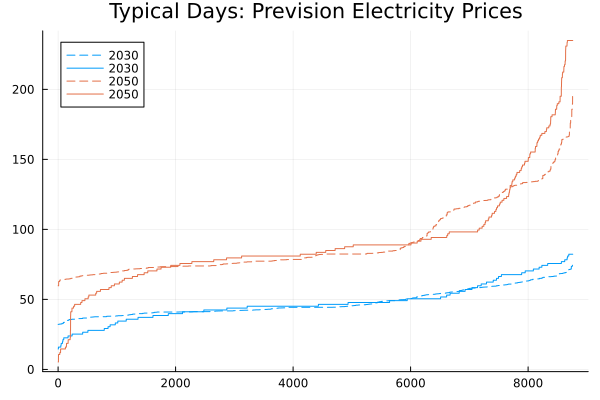

In [447]:
plot(sort(c_sale_elec_price_2030_typical[second_component[:]]), label = "2030", c=1, ls = :dash)
plot!(sort(sale_elec_price_2030), label = "2030", c =1)
plot!(sort(c_sale_elec_price_2050_typical[second_component[:]]), label = "2050", c = 2, ls = :dash)
plot!(sort(sale_elec_price_2050), label = "2050", c =2)

title!("Typical Days: Prevision Electricity Prices")
savefig("Price_duration.pdf")

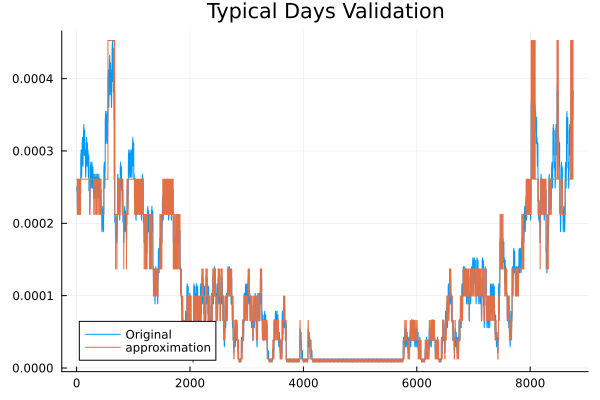

In [219]:
plot(load_profile_normalized, label = "Original", title = "Typical Days Validation")
plot!(quants[second_component[:]], label = "approximation")

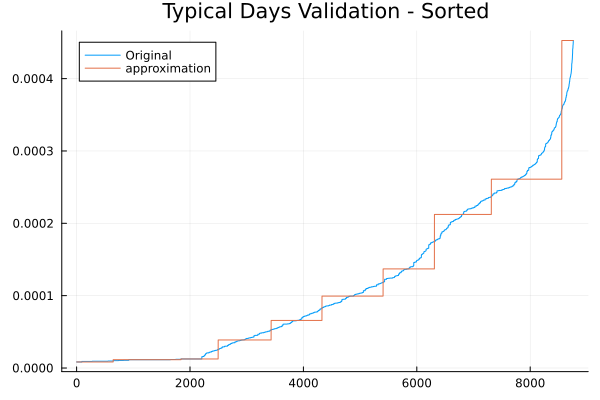

In [217]:

plot(sort(load_profile_normalized), label = "Original", title = "Typical Days Validation - Sorted")
plot!(sort(quants[second_component[:]]), label = "approximation")


<h1>Models</h1>

<h2>Data</h2>
I added the variable initial_cap_dict which you can modify to change the initial capacities and their lifetime. Beware that the capacity you entered should not exceed the value in "lifetime"

In [175]:




# Problem Data
T = 3  # Total number of years --> 2025, 2030, 2035
T_years = 5 # number of years represented by the mmodel years
c_hours = 8760

# Base annual demand
base_annual_demand = 2e6 # MWh

# Penalty cost for unmet demand (€/MWh)
c_penalty = 1.0e6

load = load_profile_normalized * base_annual_demand
maximum(load)

# Technological parameters
# Technology Names
technologies = [:CHP, :Boiler, :HeatPump]


# Lifetime in "years" (or pairs of stages)
# e.g., lifetime[:CHP] = 2 means "2 years" of operational usage
lifetime = Dict(
    :CHP => 2,
    :Boiler => 3,     # e.g. 3-year lifetime => no retirement in 3-year horizon
    :HeatPump => 2,   # only 1-year lifetime => retires quickly
)




# You can set Initial Capacities (MW)
function create_initial_cap_dict(technologies::Vector{Symbol}, max_lifetime::Int)
    initial_cap_dict = Dict{Tuple{Symbol, Int}, Int}()
    
    for tech in technologies
        for life in 0:max_lifetime
            initial_cap_dict[(tech, life)] = 0
        end
    end
    
    return initial_cap_dict
end

technologies = [:CHP, :Boiler, :HeatPump]
Max_lifetime = 5

initial_cap_dict = create_initial_cap_dict(technologies, Max_lifetime)
initial_cap_dict[:CHP,1] = 400
initial_cap_dict[:Boiler,1] = 350
initial_cap_dict[:HeatPump,2] = 100


# Print dictionary
println(initial_cap_dict)



# Operational Costs (€/MWh)
c_operational_cost = Dict(
    :CHP => 5.0,
    :Boiler => 0.75,
    :HeatPump => 1.1
)

# Investment Costs (€/MW)
c_investment_cost = Dict(
    :CHP => 2048825.0,
    :Boiler => 44528.0,
    :HeatPump => 591052.0
)

# Fixed O&M Costs (€/MW per year)
c_fixed_cost = Dict(
    :CHP => 43297.0,
    :Boiler => 1193.0,
    :HeatPump => 3316.0
)

# Maximum Additional Capacity (MW)
c_max_additional_capacity = Dict(
    :CHP => 500.0,
    :Boiler => 500.0,
    :HeatPump => 500.0
)

c_energy_carrier = Dict(
    :CHP => :nat_gas,
    :Boiler => :nat_gas,
    :HeatPump => :elec
)

# Efficiency (as a fraction)
c_efficiency_th = Dict(
    :CHP => 0.4,
    :Boiler => 0.9,
    :HeatPump => 3.0  # Coefficient of Performance (COP)
)

# Efficiency (as a fraction)
c_efficiency_el = Dict(
    :CHP => 0.5,
    :Boiler => 0.0,
    :HeatPump => 0.0  # Coefficient of Performance (COP)
)

# Emission factors (tCO2/MWh_th)
c_emission_fac = Dict(
    :nat_gas => 0.2,
    :elec => 0,
)


# Carbon Price (€/t) for years
c_carbon_price = Dict(
    1 => 100,
    2 => 200,
    3 => 300,
    4 => 400
)

salvage_fraction = 1

# Define the stochastic demand multipliers: +10%, no change, -10%
demand_multipliers = [1.1, 1.0, 0.9]

# Create a 3x3 identity matrix
I = Diagonal(ones(3))


T = 7  # Example value

# Define the matrices that will be repeated
mat1 = [0.3 0.5 0.2; 0.3 0.5 0.2; 0.3 0.5 0.2]  # The repeating matrix
I = Diagonal(ones(3))

# Initialize an empty array to store the matrices
transition_matrices = Array{Float64,2}[]

# Add the first two matrices manually
push!(transition_matrices, [1.0]')
push!(transition_matrices, [1.0]')


push!(transition_matrices, [0.3 0.5 0.2])  # Add the matrix [0.3 0.5 0.2; ...]
push!(transition_matrices, I)     # Add the identity matrix
# Dynamically add the alternating matrices based on T
for i in 1:T-2
    push!(transition_matrices, mat1)  # Add the matrix [0.3 0.5 0.2; ...]
    push!(transition_matrices, I)     # Add the identity matrix
end

println(transition_matrices)

the_iteration_limit = 100


# Log Normal distribution for the energy price
mean_price = 37.0  # Average energy price in currency units per unit of energy
price_volatility = 10.0  # Standard deviation
μ_normal = log(mean_price^2 / sqrt(price_volatility^2 + mean_price^2))
σ_normal = sqrt(log(1 + (price_volatility / mean_price)^2))
price_distribution = LogNormal(μ_normal, σ_normal)
num_price_scenarios = 10
price_quantiles = range(0.05, 0.95; length=num_price_scenarios)
price_values = quantile.(price_distribution, price_quantiles)
price_probabilities = pdf(price_distribution, price_values)
price_probabilities_normalized = price_probabilities / sum(price_probabilities)


Dict((:HeatPump, 3) => 0, (:CHP, 2) => 0, (:HeatPump, 0) => 0, (:Boiler, 1) => 350, (:HeatPump, 1) => 0, (:Boiler, 5) => 0, (:CHP, 5) => 0, (:Boiler, 4) => 0, (:CHP, 0) => 0, (:CHP, 3) => 0, (:Boiler, 0) => 0, (:HeatPump, 2) => 100, (:Boiler, 2) => 0, (:CHP, 4) => 0, (:CHP, 1) => 400, (:HeatPump, 4) => 0, (:Boiler, 3) => 0, (:HeatPump, 5) => 0)
[[1.0;;], [1.0;;], [0.3 0.5 0.2], [1.0 0.0 0.0; 0.0 1.0 0.0; 0.0 0.0 1.0], [0.3 0.5 0.2; 0.3 0.5 0.2; 0.3 0.5 0.2], [1.0 0.0 0.0; 0.0 1.0 0.0; 0.0 0.0 1.0], [0.3 0.5 0.2; 0.3 0.5 0.2; 0.3 0.5 0.2], [1.0 0.0 0.0; 0.0 1.0 0.0; 0.0 0.0 1.0], [0.3 0.5 0.2; 0.3 0.5 0.2; 0.3 0.5 0.2], [1.0 0.0 0.0; 0.0 1.0 0.0; 0.0 0.0 1.0], [0.3 0.5 0.2; 0.3 0.5 0.2; 0.3 0.5 0.2], [1.0 0.0 0.0; 0.0 1.0 0.0; 0.0 0.0 1.0], [0.3 0.5 0.2; 0.3 0.5 0.2; 0.3 0.5 0.2], [1.0 0.0 0.0; 0.0 1.0 0.0; 0.0 0.0 1.0]]


10-element Vector{Float64}:
 0.05517703795550454
 0.10613089994058338
 0.1313937458464863
 0.14183299861367246
 0.1414640921137261
 0.1323320758879828
 0.11558763902083811
 0.09183709042163361
 0.0612083595814727
 0.023036060618100176

<h1>Lifetime model</h1>
I added the "sandwich_cost" in the operational objective stage. It is equal to 0, except when you reach last stage (2*T)
Additonnally, I added +1 in lifetime to asset, and compute their power by summing from 1 to lifetime: in other words, the assets with lifetime+1 are not considered but will be considered at the next investment stage.

In [19]:

##############################################################################
# Create SDDP model
##############################################################################
# Create the Markovian policy graph
model = SDDP.MarkovianPolicyGraph(
    transition_matrices=transition_matrices,
    sense=:Min,
    lower_bound=0.0,  # Set the lower bound
    optimizer=Gurobi.Optimizer
) do sp, node
    # Unpack stage and demand state (t is stage, demand_state is 1, 2, or 3)
    t, demand_state = node

    # Variables
    @variables(sp, begin
        0 <= u_expansion_tech[tech in technologies] <= c_max_additional_capacity[tech]
        0 <= u_production_tech[tech in technologies, 1:n_typical_hours]
        0 <= u_unmet[1:n_typical_hours]
        0 <= x_annual_demand,                                                                       SDDP.State, (initial_value = base_annual_demand)
        0 <= cap[tech in technologies, lives in 0:Max_lifetime] <= 100, SDDP.State, (initial_value = initial_cap_dict[tech,lives])
    end)

    ################### Investment stage (odd-numbered stages) ###################
    if t % 2 == 1
        @constraint(sp, x_annual_demand.out == x_annual_demand.in)

        for tech in technologies
            for lives in 0:Max_lifetime
                if lives == lifetime[tech] + 1
                    @constraint(sp, cap[tech,lives].out == cap[tech,lives].in + u_expansion_tech[tech]) #Possibility to expand with brand new
                else
                    @constraint(sp, cap[tech,lives].out == cap[tech,lives].in )
                end
                
            end
        end

        investme_cost = @expression(sp, sum(c_investment_cost[tech] * u_expansion_tech[tech]     for tech in technologies))
        maintain_cost = @expression(sp, sum(cap[tech, lives].out * c_fixed_cost[tech]            for tech in technologies for lives in 1:lifetime[tech]))
        @stageobjective(sp, investme_cost + maintain_cost)
                            

        ################### Operational stage (even-numbered stages) ###################
    else
        if t == 2
            d_annual = base_annual_demand
        else
            d_annual = demand_multipliers[demand_state] * x_annual_demand.in
        end

        for hour in 1:n_typical_hours
            actual_demand = d_annual * typical_hours[hour][:value]

            @constraint(sp, sum(u_production_tech[tech, hour] for tech in technologies) + u_unmet[hour] == actual_demand)

            for tech in technologies
                @constraint(sp,
                    u_production_tech[tech, hour] <= sum(cap[tech,lives].in for lives = 1:lifetime[tech])
                )
            end
        end

        # Aging capacity by removing one life.
        @constraint(sp, [tech in technologies, lives in 1:Max_lifetime],
            cap[tech,lives-1].out == cap[tech,lives].in
        )
        @constraint(sp, [tech in technologies],
            cap[tech,Max_lifetime].out == 0
        )
        
        
        # Update annual demand state
        @constraint(sp, x_annual_demand.out == d_annual)
        
        ### Stage objective (operational costs) ###
        SDDP.parameterize(sp, price_values, price_probabilities_normalized) do ω
            # We treat (c_operational_cost[tech] + ω) as the total variable cost
            operation_cost = sum((c_operational_cost[tech] + ω) * u_production_tech[tech, hour] 
                for tech in technologies  for hour in 1:n_typical_hours)
            unmet_cost = sum(u_unmet[hour] * c_penalty * typical_hours[hour][:qty]  for hour in 1:n_typical_hours)   
            sandwich_cost = 0
            if t == 2*T
                sandwich_cost = sum(cap[tech,lives].out * c_investment_cost[tech] * lives/lifetime[tech] for tech in technologies for lives in 1:Max_lifetime)
            end
            @stageobjective(sp, operation_cost + unmet_cost - sandwich_cost)
        end
    end
end

# Train the model
SDDP.train(model; iteration_limit=100)

# Retrieve results
println("Optimal Cost: ", SDDP.calculate_bound(model))



-------------------------------------------------------------------
         SDDP.jl (c) Oscar Dowson and contributors, 2017-25
-------------------------------------------------------------------
problem
  nodes           : 38
  state variables : 19
  scenarios       : 7.29000e+09
  existing cuts   : false
options
  solver          : serial mode
  risk measure    : SDDP.Expectation()
  sampling scheme : SDDP.InSampleMonteCarlo
subproblem structure
  VariableRef                             : [82, 82]
  AffExpr in MOI.EqualTo{Float64}         : [19, 29]
  AffExpr in MOI.LessThan{Float64}        : [30, 30]
  VariableRef in MOI.GreaterThan{Float64} : [63, 63]
  VariableRef in MOI.LessThan{Float64}    : [21, 22]
numerical stability report
  matrix range     [8e-06, 1e+00]
  objective range  [1e+00, 1e+09]
  bounds range     [5e+00, 1e+02]
  rhs range        [8e-01, 1e+05]
  - matrix range contains small coefficients
  - objective range contains large coefficients
Very large or small absolut

<h2>Simulations</h2>

In [40]:

# Simulation
simulations = SDDP.simulate(model, 100, [:cap, :x_annual_demand, :u_production_tech, :u_expansion_tech, :u_unmet])

# Print simulation results
for t in 1:(T*2)
    sp = simulations[1][t]
    if t % 2 == 1  # Investment stages (odd stages)
        println("Year $(div(t + 1, 2)) - Investment Stage")
        for tech in technologies
            println("  Technology: $tech")
            println("    Expansion = ", value(sp[:u_expansion_tech][tech]))
            for lives in 0:Max_lifetime
                println("    Capacity $(String(tech)) $lives = ", value(sp[:cap][tech,lives].in))
            end
            
            println("    Expansion = ", value(sp[:u_expansion_tech][tech]))
        end
    else  # Operational stages
        println("Year $(div(t, 2)) - Operational Stage")
        println("   Demand_in = ", value(sp[:x_annual_demand].in))
        println("   Demand_out = ", value(sp[:x_annual_demand].out))
        
        total_production = sum(sum(value(sp[:u_production_tech][tech, hour] * typical_hours[hour][:qty]) for hour in 1:n_typical_hours) for tech in technologies)
        total_unmet = sum(value(sp[:u_unmet][hour] * typical_hours[hour][:qty]) for hour in 1:n_typical_hours)
        println("  Total Production = ", total_production)
        println("  Total Unmet Demand = ", total_unmet)
    end
end


plt = SDDP.SpaghettiPlot(simulations)

for tech in technologies
    SDDP.add_spaghetti(plt; title="Capacity_in_$tech") do data
        return sum(data[:cap][tech, lives].in for lives in 1:Max_lifetime)
    end
    SDDP.add_spaghetti(plt; title="Capacity_out_$tech") do data
        return sum(data[:cap][tech, lives].out for lives in 1:Max_lifetime)
    end
    SDDP.add_spaghetti(plt; title="Expansion_$tech") do data
        return data[:u_expansion_tech][tech]
    end
    SDDP.add_spaghetti(plt; title="Production_$tech") do data
        return sum(data[:u_production_tech][tech, :])
    end
end


SDDP.add_spaghetti(plt; title="Annual Demand_in") do data
    return data[:x_annual_demand].in
end
SDDP.add_spaghetti(plt; title="Annual Demand_out") do data
    return data[:x_annual_demand].out
end
SDDP.add_spaghetti(plt; title="Total Production") do data
    return sum(sum((data[:u_production_tech][tech, hour] * typical_hours[hour][:qty]) for hour in 1:n_typical_hours) for tech in technologies)
end
SDDP.add_spaghetti(plt; title="Unmet Demand") do data
    return sum(data[:u_unmet])
end

SDDP.plot(plt, "spaghetti_plot.html")

Year 1 - Investment Stage
  Technology: CHP
    Expansion = 5.0
    Capacity CHP 0 = 0.0
    Capacity CHP 1 = 20.0
    Capacity CHP 2 = 0.0
    Capacity CHP 3 = 0.0
    Capacity CHP 4 = 0.0
    Capacity CHP 5 = 0.0
    Expansion = 5.0
  Technology: Boiler
    Expansion = 10.0
    Capacity Boiler 0 = 0.0
    Capacity Boiler 1 = 20.0
    Capacity Boiler 2 = 0.0
    Capacity Boiler 3 = 0.0
    Capacity Boiler 4 = 0.0
    Capacity Boiler 5 = 0.0
    Expansion = 10.0
  Technology: HeatPump
    Expansion = 30.0
    Capacity HeatPump 0 = 0.0
    Capacity HeatPump 1 = 20.0
    Capacity HeatPump 2 = 0.0
    Capacity HeatPump 3 = 0.0
    Capacity HeatPump 4 = 0.0
    Capacity HeatPump 5 = 0.0
    Expansion = 30.0
Year 1 - Operational Stage
   Demand_in = 100000.0
   Demand_out = 100000.0
  Total Production = 98297.03143028746
  Total Unmet Demand = 0.0
Year 2 - Investment Stage
  Technology: CHP
    Expansion = 0.0
    Capacity CHP 0 = 20.0
    Capacity CHP 1 = 0.0
    Capacity CHP 2 = 0.0
    C

<h2>Visualization</h2>

[:CHP, :HeatPump, :Boiler]
 CHP 84353.48553714482
 CHP 32995.38607370611
 CHP 32995.38607370611
 CHP 56510.24290828599
 CHP 57796.05525368387
 CHP 55878.685844264444
 CHP 57102.87268550843
 HeatPump 12874.118675951971
 HeatPump 63217.218139390694
 HeatPump 63217.218139390694
 HeatPump 38645.73182150988
 HeatPump 46270.67989742165
 HeatPump 40288.12530163307
 HeatPump 47974.69888169878
 Boiler 1069.4272171906835
 Boiler 2030.0
 Boiler 2084.4272171906837
 Boiler 3141.0567004916124
 Boiler 4059.9994222106825
 Boiler 2130.2202843899613
 Boiler 3049.1630061090364


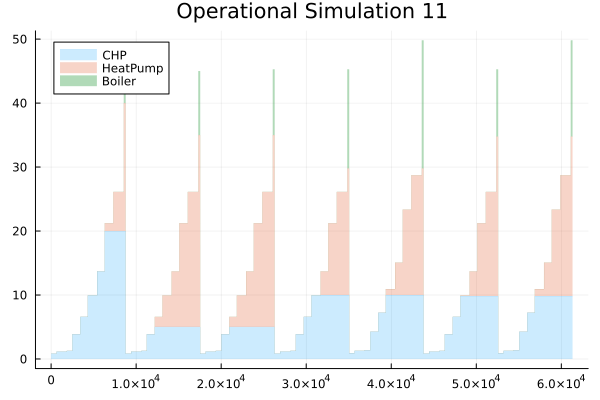

In [42]:

colors = Dict

n_sim = 11


plt = plot(title = "Operational Simulation $n_sim")
y0 = zeros(8760*T, length(technologies))
labels = Vector{String}()

sorted_keys = sort(collect(c_operational_cost), by = x -> x[2])  # Sort by value
enumerated_keys = [pair[1] for pair in sorted_keys]  # Extract sorted keys
println(enumerated_keys)
for (index,tech) in enumerate(enumerated_keys)
    for t_prim in 1:(T)
        t = 2 * t_prim
        sp = simulations[n_sim][t]
        total_unmet = sum(value(sp[:u_unmet][hour]  * typical_hours[hour][:qty]) for hour in 1:n_typical_hours)
        y0[1+8760*(t_prim-1):8760*t_prim,index] = sort(Array(values(sp[:u_production_tech][tech,:]))[second_component[:]])
        prod_tot = (sum(Array(values(sp[:u_production_tech][tech,:]))[second_component[:]]))
        # vline(1+8760*(t_prim-1))
        print(" $(tech) $(prod_tot)" )
        println()
    end
    
    push!(labels, String(tech))
end
# print(labels)
# labels = string.(Any["CHP", "HeatPump", "Boiler"])
# println(hcat(labels))
areaplot!(y0,label = Matrix(reshape(labels,1,length(labels))),fillalpha = [0.2 0.3 0.4], lw = 0)


display(plt)


[6.909868872245395 19.665336687961343 62.76407176195089 46.10838094865222 95.14007958638008; 64.07231548028741 63.039450520091265 69.16933091411414 52.1284337294464 53.2242560468499; 23.057943056617724 3.8506769463197865 50.54290397600484 62.905988262081344 77.53560458253004; 61.88890853587564 45.633762107172494 43.477561054757416 0.6248219161653967 0.04428836009853221; 63.600336636083746 25.58804704004909 31.343372975577243 24.78996257557481 27.43925397987551; 64.6966313091934 55.409767383183464 55.92693959720583 74.5167573565118 28.136645309247022; 72.24330144002778 50.929454849366806 66.84300774679808 58.84359567957732 62.17764509348975; 74.49209540754839 85.36589335648294 4.439956506129916 79.44211993929301 87.53290435378612; 25.913014277186818 18.1372861893473 26.23216328821103 41.47055450837893 69.44599029860036; 29.69016517017662 43.88216393435827 45.41544340778082 91.13082727035024 97.90302859612122]

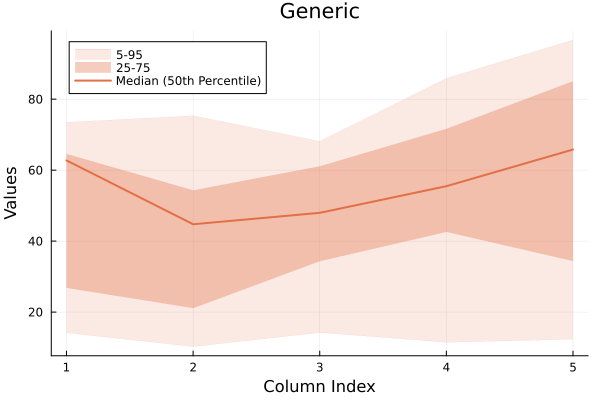

In [471]:

# Sample matrix: 10 rows (observations) and 5 columns (stages)
data = rand(10, 5) * 100  # Replace with your actual matrix
print(data)


function plot_bands(data, title,xlabels)
    # Compute statistics for each column (apply quantile to each column)
    x_values =xlabels  # Column indices as x-axis
    q5 = [quantile(data[:, i], 0.05) for i in 1:size(data, 2)]
    q25 = [quantile(data[:, i], 0.25) for i in 1:size(data, 2)]
    q50 = [quantile(data[:, i], 0.50) for i in 1:size(data, 2)]  # Median (50th percentile)
    q75 = [quantile(data[:, i], 0.75) for i in 1:size(data, 2)]
    q95 = [quantile(data[:, i], 0.95) for i in 1:size(data, 2)]
    
    # Create plot
    plot(x_values, q5, fillrange = q95, fillalpha = 0.15,  c = 2, label = "5-95", legend = :topleft,lw = 0)
    plot!(x_values, q25, fillrange = q75, fillalpha = 0.35, c = 2, label = "25-75", legend = :topleft,lw = 0)
    plot!(x_values, q95, fillalpha = 0.15,  c = 2, label = "", legend = :topleft,lw = 0)
    plot!(x_values, q75, fillalpha = 0.35, c = 2, label = "", legend = :topleft,lw = 0)
    plot!(x_values, q50, label="Median (50th Percentile)", lw=2, color=2)  # Median line
    
    # Labels and title
    xlabel!("Column Index")
    ylabel!("Values")
    title!(title)
    # display()
end

plot_bands(data,"Generic", 1:5)

In [475]:
length(simulations)
println(T)

variable = :x_annual_demand
ope_var = zeros(length(simulations), T)

xlabels = []

    for (ope_stage, stage) in enumerate(2:2:14)
        push!(xlabels, 2010 + ope_stage*10)
    for sim in 1:length(simulations)
        # println("$ope_stage $stage")
        # print(simulations[n_sim][stage][:x_annual_demand])
        ope_var[sim,ope_stage] = values(simulations[sim][stage][:x_annual_demand].out)
    end
end


plot_bands(ope_var, "Annual demand", xlabels)
savefig("Demand Evolution.pdf")


7


attempt to save state beyond implementation limit


"/home/vub-flow/Documents/Code SDDP/Online_code/Demand Evolution.pdf"

In [54]:

function even_elements_at_even_indices(arr)
    println(arr)
    return [arr[i] for i in 2:2:length(arr) if arr[i] % 2 == 0]
end

println(simulations)

Plots.plot(
    SDDP.publication_plot(simulations; title = "Demand in") do data
        even_elements_at_even_indices(data[:x_annual_demand].out)
        return data[:x_annual_demand].out
    end,
    SDDP.publication_plot(simulations; title = "CHP Production") do data
        return (sum(Array(values(data[:u_production_tech][:CHP,:]))[second_component[:]]))
    end;
    xlabel = "Stage",
    # ylims = (0, 200),
    layout = (1, 2),
)

Vector{Dict{Symbol, Any}}[[Dict(:bellman_term => 3.1940977967124224e8, :node_index => (1, 1), :objective_state => nothing, :belief => Dict((1, 1) => 1.0), :stage_objective => 65300.0, :cap => 2-dimensional DenseAxisArray{SDDP.State{Float64},2,...} with index sets:
    Dimension 1, [:CHP, :Boiler, :HeatPump]
    Dimension 2, 0:5
And data, a 3×6 Matrix{SDDP.State{Float64}}:
 SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(20.0, 20.0)  SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(0.0, 0.0)   SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(0.0, 5.0)
 SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(20.0, 20.0)  SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(0.0, 10.0)  SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(0.0, 0.0)
 SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(20.0, 20.0)  SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(0.0, 30.0)  SDDP.State{Float64}(0.0, 0.0)  SDDP.State{Float64}(0.0, 0.0), :u_expansion_tech => 1-dimensional DenseAxisArray{Float64

Excessive output truncated after 524294 bytes.

:
 SDDP.State{Float64}(5.0, 5.0)                              SDDP.State{Float64}(0.251861051479097, 0.251861051479097)  SDDP.State{Float64}(5.0, 5.0)                                SDDP.State{Float64}(0.0, 0.0)                SDDP.State{Float64}(3.798242637400766, 3.798242637400766)  SDDP.State{Float64}(0.0, 0.0)
 SDDP.State{Float64}(10.0, 10.0)                            SDDP.State{Float64}(10.0, 10.0)                            SDDP.State{Float64}(10.0, 10.0)                              SDDP.State{Float64}(0.0, 10.0)               SDDP.State{Float64}(0.0, 0.0)                              SDDP.State{Float64}(0.0, 0.0)
 SDDP.State{Float64}(19.54306419752987, 19.54306419752987)  SDDP.State{Float64}(0.0, 0.0)                              SDDP.State{Float64}(16.218010681519917, 16.218010681519917)  SDDP.State{Float64}(0.0, 4.778672541788088)  SDDP.State{Float64}(0.0, 0.0)                              SDDP.State{Float64}(0.0, 0.0), :u_expansion_tech => 1-dimensional DenseAxisArray{Float

<h1>Old models</h1>
<h2>Model without typical days</h2>

In [12]:

t1 = time()

# the code below prints the markovian graph
SDDP.MarkovianGraph(transition_matrices)

# Create the Markovian policy graph
model = SDDP.MarkovianPolicyGraph(
    transition_matrices=transition_matrices,
    sense=:Min,
    lower_bound=0.0,  # Set the lower bound
    optimizer=Gurobi.Optimizer
) do sp, node
    # Unpack stage and demand state (t is stage, demand_state is 1, 2, or 3)
    t, demand_state = node

    # Variables
    @variables(sp, begin
        # Capacity State Variables for each technology
        0 <= x_capacity_tech[tech in technologies] <= 1000, SDDP.State, (initial_value = c_initial_capacity[tech])
        # Investment pipeline.
        #   pipeline.out are the investments made in the current stage
        #   pipeline.in are the investments that becomes available at this stage
        #     and can be added to the capacity.
        #   Investments move up one slot in the pipeline each stage.
        # Pipeline State Variables for each technology
        0 <= pipeline_tech[tech in technologies] <= c_max_additional_capacity[tech], SDDP.State, (initial_value = 0)
        # Investment Decision Variables for each technology
        0 <= u_expansion_tech[tech in technologies] <= c_max_additional_capacity[tech]
        # Production Variables for each technology
        u_production_tech[tech in technologies, 1:c_hours] >= 0
        # Demand state
        0 <= x_annual_demand, SDDP.State, (initial_value = base_annual_demand)
        # Unmet demand per hour
        u_unmet[1:c_hours] >= 0
    end)

    ################### Investment stage (odd-numbered stages) ###################
    if t % 2 == 1
        # Update capacity without adding pipeline contributions
        @constraint(sp, [tech in technologies], x_capacity_tech[tech].out == x_capacity_tech[tech].in)
        # Maintain annual demand state
        @constraint(sp, x_annual_demand.out == x_annual_demand.in)
        # Add the expansion decision to the pipeline for each technology
        @constraint(sp, [tech in technologies], pipeline_tech[tech].out == u_expansion_tech[tech])
        # Stage objective: expansion cost
        @stageobjective(sp, 
        sum(c_investment_cost[tech] * u_expansion_tech[tech] for tech in technologies) +
        sum(c_fixed_cost[tech] * x_capacity_tech[tech].out for tech in technologies)
        )

    ################### Operational stage (even-numbered stages) ###################
    else
        # ensure that annual demand is not changed in the first year
        if t == 2
            d_annual = base_annual_demand
        else
            # Annual demand adjustment based on the stochastic demand state
            d_annual = demand_multipliers[demand_state] * x_annual_demand.in
        end

        # Apply constraints for production and unmet demand based on the stochastic annual demand
        for hour in 1:c_hours
            actual_demand = d_annual * load_profile_normalized[hour]
        
            # Total production from all technologies plus unmet demand meets the actual demand
            @constraint(sp, sum(u_production_tech[tech, hour] for tech in technologies) + u_unmet[hour] == actual_demand)
        
            # Capacity constraints for each technology
            @constraint(sp, [tech in technologies], u_production_tech[tech, hour] <= x_capacity_tech[tech].in)
        end

        # Update capacity with the investments in the pipeline  for each technology
        @constraint(sp, [tech in technologies], x_capacity_tech[tech].out == x_capacity_tech[tech].in + pipeline_tech[tech].in) 

        # Update annual demand state
        @constraint(sp, x_annual_demand.out == d_annual)

        # Reset the pipeline for each technology
        @constraint(sp, [tech in technologies], pipeline_tech[tech].out == 0)

        # Stage objective (operational costs)
        SDDP.parameterize(sp, price_values, price_probabilities_normalized) do ω
            # We treat (c_operational_cost[tech] + ω) as the total variable cost
            @stageobjective(sp,
                sum((c_operational_cost[tech] + ω) * u_production_tech[tech, hour]
                    for tech in technologies, hour in 1:c_hours ) +
                sum(u_unmet[hour] * c_penalty for hour in 1:c_hours)
            )
        end
    end
end

# Train the model
SDDP.train(model; iteration_limit=the_iteration_limit)

# Retrieve results
println("Optimal Cost: ", SDDP.calculate_bound(model))

# Simulation
simulations = SDDP.simulate(model, 100, [:x_capacity_tech, :x_annual_demand, :u_production_tech, :u_expansion_tech, :u_unmet])

# Print simulation results
for t in 1:(T*2)
    sp = simulations[1][t]
    if t % 2 == 1  # Investment stages (odd stages)
        println("Year $(div(t + 1, 2)) - Investment Stage")
        for tech in technologies
            println("  Technology: $tech")
            println("    Capacity_in = ", value(sp[:x_capacity_tech][tech].in))
            println("    Expansion = ", value(sp[:u_expansion_tech][tech]))
            println("    Capacity_out = ", value(sp[:x_capacity_tech][tech].out))
        end
    else  # Operational stages
        println("Year $(div(t, 2)) - Operational Stage")
        println("   Demand_in = ", value(sp[:x_annual_demand].in))
        println("   Demand_out = ", value(sp[:x_annual_demand].out))
        total_production = sum(sum(value(sp[:u_production_tech][tech, hour]) for hour in 1:c_hours) for tech in technologies)
        total_unmet = sum(value(sp[:u_unmet][hour]) for hour in 1:c_hours)
        println("  Total Production = ", total_production)
        println("  Total Unmet Demand = ", total_unmet)
    end
end


plt = SDDP.SpaghettiPlot(simulations)

for tech in technologies
    SDDP.add_spaghetti(plt; title="Capacity_in_$tech") do data
        return data[:x_capacity_tech][tech].in
    end
    SDDP.add_spaghetti(plt; title="Capacity_out_$tech") do data
        return data[:x_capacity_tech][tech].out
    end
    SDDP.add_spaghetti(plt; title="Expansion_$tech") do data
        return data[:u_expansion_tech][tech]
    end
    SDDP.add_spaghetti(plt; title="Production_$tech") do data
        return sum(data[:u_production_tech][tech, :])
    end
end

SDDP.add_spaghetti(plt; title="Annual Demand_in") do data
    return data[:x_annual_demand].in
end
SDDP.add_spaghetti(plt; title="Annual Demand_out") do data
    return data[:x_annual_demand].out
end
SDDP.add_spaghetti(plt; title="Total Production") do data
    return sum(sum((data[:u_production_tech][tech, hour]) for hour in 1:c_hours) for tech in technologies)
end
SDDP.add_spaghetti(plt; title="Unmet Demand") do data
    return sum(data[:u_unmet])
end

SDDP.plot(plt, "spaghetti_plot_no_typical_days.html")


t2 = time()

println("Elapsed time $(t2-t1)")

LoadError: UndefVarError: `c_initial_capacity` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

<h2>Simple typical days </h2>

In [14]:

t1 = time()

SDDP.MarkovianGraph(transition_matrices)

# Create the Markovian policy graph
model = SDDP.MarkovianPolicyGraph(
    transition_matrices=transition_matrices,
    sense=:Min,
    lower_bound=0.0,  # Set the lower bound
    optimizer=Gurobi.Optimizer
) do sp, node
    t, demand_state = node

    # Variables: The variables u_production_tech and u_unmet are redefined to correspond to typical hour format
    @variables(sp, begin
        0 <= x_capacity_tech[tech in technologies]                       <= 1000,                            SDDP.State, (initial_value = c_initial_capacity[tech])
        0 <= pipeline_tech[tech in technologies]                         <= c_max_additional_capacity[tech], SDDP.State, (initial_value = 0)
        0 <= u_expansion_tech[tech in technologies]                      <= c_max_additional_capacity[tech]
        0 <= u_production_tech[tech in technologies, 1:n_typical_hours]
        0 <= x_annual_demand,                                                                                SDDP.State, (initial_value = base_annual_demand)
        0 <= u_unmet[1:n_typical_hours]
    end)

    ################### Investment stage (odd-numbered stages) ###################
    if t % 2 == 1
        @constraint(sp, [tech in technologies], x_capacity_tech[tech].out == x_capacity_tech[tech].in)
        @constraint(sp, x_annual_demand.out == x_annual_demand.in)
        @constraint(sp, [tech in technologies], pipeline_tech[tech].out == u_expansion_tech[tech])
        @stageobjective(sp, 
        sum(c_investment_cost[tech] * u_expansion_tech[tech] for tech in technologies) +
        sum(c_fixed_cost[tech] * x_capacity_tech[tech].out for tech in technologies)
        )

    ################### Operational stage (even-numbered stages) ###################
    else
        if t == 2
            d_annual = base_annual_demand
        else
            d_annual = demand_multipliers[demand_state] * x_annual_demand.in
        end

        # This loop is redefined in accordance to typical hour format
        for hour in 1:n_typical_hours
            actual_demand = d_annual * typical_hours[hour][:value]
            @constraint(sp, sum(u_production_tech[tech, hour] for tech in technologies) + u_unmet[hour] == actual_demand)
            @constraint(sp, [tech in technologies], u_production_tech[tech, hour] <= x_capacity_tech[tech].in)
        end

        @constraint(sp, [tech in technologies], x_capacity_tech[tech].out == x_capacity_tech[tech].in + pipeline_tech[tech].in) 
        @constraint(sp, x_annual_demand.out == d_annual)
        @constraint(sp, [tech in technologies], pipeline_tech[tech].out == 0)
        SDDP.parameterize(sp, price_values, price_probabilities_normalized) do ω

            # The stage objective is adapted: each typical hour is multiplied by the number of times it occurs
            @stageobjective(sp,
                sum(
                    (sum(
                            (c_operational_cost[tech] + ω) * u_production_tech[tech, hour] for tech in technologies
                        ) +
                    u_unmet[hour] * c_penalty
                    ) * typical_hours[hour][:qty] for hour in 1:n_typical_hours)) 
            
        end
    end
end

# Train the model
SDDP.train(model; iteration_limit=the_iteration_limit)

# Retrieve results
println("Optimal Cost: ", SDDP.calculate_bound(model))

# Simulation
simulations = SDDP.simulate(model, 100, [:x_capacity_tech, :x_annual_demand, :u_production_tech, :u_expansion_tech, :u_unmet])

# Print simulation results
for t in 1:(T*2)
    sp = simulations[1][t]
    if t % 2 == 1  # Investment stages (odd stages)
        println("Year $(div(t + 1, 2)) - Investment Stage")
        for tech in technologies
            println("  Technology: $tech")
            println("    Capacity_in = ", value(sp[:x_capacity_tech][tech].in))
            println("    Expansion = ", value(sp[:u_expansion_tech][tech]))
            println("    Capacity_out = ", value(sp[:x_capacity_tech][tech].out))
        end
    else  # Operational stages
        println("Year $(div(t, 2)) - Operational Stage")
        println("   Demand_in = ", value(sp[:x_annual_demand].in))
        println("   Demand_out = ", value(sp[:x_annual_demand].out))
        total_production = sum(sum(value(sp[:u_production_tech][tech, hour] * typical_hours[hour][:qty]) for hour in 1:n_typical_hours) for tech in technologies)
        total_unmet = sum(value(sp[:u_unmet][hour]  * typical_hours[hour][:qty]) for hour in 1:n_typical_hours)
        println("  Total Production = ", total_production)
        println("  Total Unmet Demand = ", total_unmet)
    end
end


plt = SDDP.SpaghettiPlot(simulations)

for tech in technologies
    SDDP.add_spaghetti(plt; title="Capacity_in_$tech") do data
        return data[:x_capacity_tech][tech].in
    end
    SDDP.add_spaghetti(plt; title="Capacity_out_$tech") do data
        return data[:x_capacity_tech][tech].out
    end
    SDDP.add_spaghetti(plt; title="Expansion_$tech") do data
        return data[:u_expansion_tech][tech]
    end
    SDDP.add_spaghetti(plt; title="Production_$tech") do data
        return sum(data[:u_production_tech][tech, hour]  * typical_hours[hour][:qty] for hour in 1:n_typical_hours)
    end
end

SDDP.add_spaghetti(plt; title="Annual Demand_in") do data
    return data[:x_annual_demand].in
end
SDDP.add_spaghetti(plt; title="Annual Demand_out") do data
    return data[:x_annual_demand].out
end
SDDP.add_spaghetti(plt; title="Total Production") do data
    return sum(sum((data[:u_production_tech][tech, hour] * typical_hours[hour][:qty]) for hour in 1:n_typical_hours) for tech in technologies)
end
SDDP.add_spaghetti(plt; title="Unmet Demand") do data
    return sum(data[:u_unmet])
end

SDDP.plot(plt, "spaghetti_plot_typical_days.html")


t2 = time()

println("Elapsed time $(t2-t1)")

LoadError: UndefVarError: `c_initial_capacity` not defined in `Main`
Suggestion: check for spelling errors or missing imports.